In [1]:
import scanpy as sc
import pandas as pd
from scipy import io
from scipy.sparse import csr_matrix
import anndata
#Load background software
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import matplotlib
import scrublet as scr
import anndata
import csv
import stream2 as st2
import seaborn as sns

C:\Users\coron\miniconda3\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
sc.settings.set_figure_params(dpi=133) #Figure pixel resolution settings

In [3]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [4]:
import scanpy as sc

# Read your data (you already did this)
adata10 = sc.read_h5ad("C:/Users/coron/OneDrive/Desktop/snRNAseq/snRNAseq_St105_Processed-Annotated.h5ad")
adata11 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/Parse_St11_Xenbase/WTSt11_HandAnnotated_TryingTo1000GenesPerCellUpdate_AllFinishedPOG_CementGlandFixed.h5ad')

adata12 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/St12_NewAlignment/WT/St12_WT_UpdatedGeneNames.h5ad')
adata12.X = adata12.X.astype('float32')  # or float64
sc.pp.normalize_per_cell(adata12, counts_per_cell_after=1e4)
sc.pp.log1p(adata12)

adata12_5 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/St12_NewAlignment/WT/St12-5_WT_UpdatedGeneNames.h5ad')
adata12_5.X = adata12_5.X.astype('float32')  # or float64
sc.pp.normalize_per_cell(adata12_5, counts_per_cell_after=1e4)
sc.pp.log1p(adata12_5)

adata13 = sc.read_h5ad('C:/Users/coron/OneDrive/Desktop/snRNAseq/St13/St13_WT_UpdatedGeneNames.h5ad')
adata13.X = adata13.X.astype('float32')  # or float64
sc.pp.normalize_per_cell(adata13, counts_per_cell_after=1e4)
sc.pp.log1p(adata13)


# Define adatas and the annotation columns you want to copy
adatas_info = [
    (adata10, "10", "Cell_Type"),
    (adata11, "11", "leiden_12.0"),
    (adata12, "12", "leiden_12.0"),
    (adata12_5, "12.5", "refined_region_annotation"),
    (adata13, "13", "refined_region_annotation")
]

# Process all adatas
processed_adatas = []

for adata, stage, orig_col in adatas_info:
    adata = adata.copy()
    
    adata.var_names_make_unique()
    adata.raw = None
    
    # Rename the annotation column
    new_col = f"annotation_stage_{stage}"
    adata.obs[new_col] = adata.obs[orig_col].astype(str)

    # Make obs_names unique (optional but safe)
    adata.obs_names = [f"{name}_{stage}_{i}" for i, name in enumerate(adata.obs_names)]

    # Add metadata
    adata.obs["annot_with_stage"] = adata.obs[new_col] + f"_{stage}"
    adata.obs["stage"] = stage

    processed_adatas.append(adata)

# Final merge
adata_all = sc.concat(
    processed_adatas,
    label="original_stage",
    keys=[stage for _, stage, _ in adatas_info],
    index_unique=None
)


C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique

In [87]:
adatas_info = [
    (adata10, "10", "Cell_Type", ["Neural Plate"]),
    (adata11, "11", "leiden_12.0", ["Neural Plate St11-WT", "Neural Plate HB St11-WT"]),
    (adata12, "12", "leiden_12.0", [
        "Anterior Neural Ridge St12-WT", "Neural Plate St12-WT", "Neural Plate FB St12-WT",
        "Neural Plate HB St12-WT", "Notoplate St12-WT"
    ]),
    (adata12_5, "12.5", "refined_region_annotation", [
        "Anterior Neural Plate", "Anterior Neural Ridge", "Early Neuron", 
        "Neural Plate", "Neural Plate HB", "Notoplate"
    ]),
    (adata13, "13", "refined_region_annotation", [
        "Anterior Neural Plate", "Anterior Neural Ridge", "Early Neuron", 
        "Neural Plate", "Neural Plate HB", 
         "Notoplate"
    ])
]



subsetted_adatas = []

for adata, stage, orig_col, annotations in adatas_info:
    adata = adata.copy()

    # Clean var names (ensure they are unique without altering the names too much)
    adata.var_names_make_unique()  # This ensures unique gene names without turning them into numbers

    # Kill .raw, it causes concat to explode if var isn't aligned
    adata.raw = None

    # Rename the annotation column
    new_col = f"annotation_stage_{stage}"
    adata.obs[new_col] = adata.obs[orig_col].astype(str)

    # Subset based on annotations
    mask = adata.obs[new_col].isin(annotations)
    sub_adata = adata[mask].copy()

    # Ensure the original gene names remain unchanged in the final concatenated object
    sub_adata.var_names = adata.var_names  # Keep original gene names intact

    # Unique obs names (optional, this ensures that obs names are unique across stages)
    sub_adata.obs_names = [f"{name}_{stage}_{i}" for i, name in enumerate(sub_adata.obs_names)]

    # Add metadata
    sub_adata.obs["annot_with_stage"] = sub_adata.obs[new_col] + f"_{stage}"
    sub_adata.obs["stage"] = stage

    subsetted_adatas.append(sub_adata)

# Final concatenation
adata_comb = sc.concat(
    subsetted_adatas,
    label="original_stage",
    keys=[info[1] for info in adatas_info],
    index_unique=None
)


C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\coron\miniconda3\Lib\site-packages\anndata\_core\anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [236]:
import pandas as pd
import numpy as np

# Get dense matrix safely
X = adata_comb.X.toarray() if hasattr(adata_comb.X, "toarray") else adata_comb.X

# Build expression DataFrame
expr_df = pd.DataFrame(X, index=adata_comb.obs_names, columns=adata_comb.var_names)

# Add cluster annotations
expr_df["annot_with_stage"] = adata_comb.obs["annot_with_stage"].values

# Step 1: Filter out genes expressed in 50 or fewer cells
non_zero_counts = (expr_df.drop(columns='annot_with_stage') > 0).sum(axis=0)
genes_to_keep = non_zero_counts[non_zero_counts > 50].index
expr_df_filtered = expr_df[genes_to_keep]

# Preserve annotation
expr_df_filtered["annot_with_stage"] = expr_df["annot_with_stage"]

# Step 2: Mean expression per cluster
mean_expr = expr_df_filtered.groupby("annot_with_stage").mean()

# Step 3: Specificity scores
spec_scores = mean_expr.div(mean_expr.sum(axis=0), axis=1).fillna(0)

# Step 4: Top 20 specific genes per cluster
top_genes_per_cluster = {
    cluster: spec_scores.loc[cluster].sort_values(ascending=False).head(15)
    for cluster in spec_scores.index
}

# Convert to DataFrame
top_genes_df = pd.DataFrame.from_dict(top_genes_per_cluster, orient="index").transpose()

# Optionally save
#top_genes_df.to_csv("NeuralPlateSubset_top_15_specific_genes_per_cluster_50cellsExpMin.csv")

# View top rows
top_genes_df.head()


C:\Users\coron\AppData\Local\Temp\ipykernel_1904\2412046212.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  expr_df_filtered["annot_with_stage"] = expr_df["annot_with_stage"]


,Anterior Neural Plate_12.5,Neural Plate FB St12-WT_12,Anterior Neural Plate_13,Anterior Neural Ridge St12-WT_12,Anterior Neural Ridge_12.5,Anterior Neural Ridge_13,Early Neuron_12.5,Neural Plate_12.5,Early Neuron_13,Neural Plate St12-WT_12,Neural Plate_10,Neural Plate HB St12-WT_12,Neural Plate HB St11-WT_11,Neural Plate St11-WT_11,Neural Plate HB_12.5,Neural Plate HB_13,Neural Plate_13,Notoplate St12-WT_12,Notoplate_12.5,Notoplate_13
dmrt3,0.276189,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rax,0.237818,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
scnn1b,0.236830,0.291837,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
rtn4ip1,0.235880,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
uroc1,0.190730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
import pandas as pd
import numpy as np

# 1. Load Ira TF gene list
IraTF = pd.read_csv('C:/Users/coron/OneDrive/Desktop/snRNAseq/Stage12_Parse_WT/CompleteTFlist_XtropIraPaper.csv')
ira_tf_genes = set(IraTF['Gene'].str.strip('" \t'))

# 2. Use adata_all directly
X = adata_all.X.toarray() if hasattr(adata_all.X, "toarray") else adata_all.X
expr_df = pd.DataFrame(X, index=adata_all.obs_names, columns=adata_all.var_names)

# 3. Filter columns (genes) to only those in IraTF list (MUCH smaller matrix)
ira_tf_genes_in_data = list(set(expr_df.columns).intersection(ira_tf_genes))
expr_df = expr_df[ira_tf_genes_in_data]

# 4. Add cluster annotations
expr_df["annot_with_stage"] = adata_all.obs["annot_with_stage"].values

# 5. Filter genes: keep only those expressed in >50 cells
non_zero_counts = (expr_df.drop(columns='annot_with_stage') > 0).sum(axis=0)
genes_to_keep = non_zero_counts[non_zero_counts > 50].index
expr_df_filtered = expr_df[genes_to_keep]

# 6. Preserve annotation
expr_df_filtered["annot_with_stage"] = expr_df["annot_with_stage"]

# 7. Compute mean expression per cluster
mean_expr = expr_df_filtered.groupby("annot_with_stage").mean()

# 8. Compute specificity scores (per cluster)
spec_scores = mean_expr.div(mean_expr.sum(axis=0), axis=1).fillna(0)

# 9. Get top N TFs per cluster
top_genes_per_cluster_tf = {
    cluster: spec_scores.loc[cluster].sort_values(ascending=False).head(15)
    for cluster in spec_scores.index
}

# 10. Convert to DataFrame
top_genes_df_tf = pd.DataFrame.from_dict(top_genes_per_cluster_tf, orient="index").transpose()

# 11. Optional: Save
top_genes_df_tf.to_csv("Top15_TFs_per_cluster_filtered.csv")

# 12. View results
top_genes_df_tf.head()


C:\Users\coron\AppData\Local\Temp\ipykernel_16828\2224689239.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  expr_df_filtered["annot_with_stage"] = expr_df["annot_with_stage"]


,Anterior Neural Plate_12.5,Anterior Neural Plate_13,Anterior Neural Ridge_12.5,Anterior Neural Ridge_13,NP Superficial St12-WT_12,Neural Plate FB St12-WT_12,Cil. Epi. Prog. St12-WT_12,Ciliated Epidermal Prog._12.5,six1/eya1 PPR_12.5,Neural Plate St12-WT_12,...,Neural Crest_12.5,Neural Plate Border_12.5,six1/eya1 PPR_13,Involuting Dorsal Mesoderm_10,Lateral Mesoderm_12.5,Notochord_12.5,Vent Inv Meso St11-WT_11,NPB St12-WT_12,Involuting Ventral Endoderm_10,L/R Org. Primordium_12.5
rax,0.158502,0.153503,0.071527,0.069940,0.043472,0.120380,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dmrt3,0.137902,NaN,0.084739,0.070682,NaN,0.088795,0.055538,0.042989,0.04398,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
lhx2,0.129375,0.143483,NaN,0.112920,NaN,0.115101,NaN,NaN,NaN,0.031283,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fezf2,0.119169,NaN,0.061532,NaN,0.065318,0.123201,NaN,NaN,NaN,0.041498,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fezf1,0.102989,0.126787,0.081459,0.301265,NaN,0.059243,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [237]:
# Step 1: Make a copy of adata_comb
adata_HVG = adata_comb.copy()  # Use .copy() to avoid modifying the original data

# Step 2: Extract the gene names from the index of top_genes_df
top_genes = top_genes_df.index.unique()  # Get unique gene names from the index

# Step 3: Check if these top_genes are present in the var_names of adata_comb
print("Top genes:", top_genes[:10])  # Print a subset of top genes for inspection
print("adata_HVG.var_names:", adata_HVG.var_names[:10])  # Print a subset of adata_HVG.var_names for inspection

# Step 4: Filter genes in adata_comb based on the top_genes list
genes_to_keep = [gene for gene in top_genes if gene in adata_HVG.var_names]

# Check if any genes were kept
print("Genes to keep:", genes_to_keep[:10])  # Print first few genes to verify

# Step 5: Subset the data to keep only the selected genes
adata_HVG = adata_HVG[:, genes_to_keep]

# Step 6: Display a summary of the new AnnData object
print(adata_HVG)


Top genes: Index(['dmrt3', 'rax', 'scnn1b', 'rtn4ip1', 'uroc1', 'pdp2', 'lhx2', 'cbln1',
       'fezf2', 'pigw'],
      dtype='object')
adata_HVG.var_names: Index(['nsfl1c', 'clul1', 'vwc2l', 'slc47a1', 'ikbkg', 'optc', 'u2af1',
       'phka2', 'nup214', 'mfsd12'],
      dtype='object')
Genes to keep: ['dmrt3', 'rax', 'scnn1b', 'rtn4ip1', 'uroc1', 'pdp2', 'lhx2', 'cbln1', 'fezf2', 'pigw']
View of AnnData object with n_obs × n_vars = 10227 × 284
    obs: 'annot_with_stage', 'stage', 'original_stage'
    obsm: 'X_pca', 'X_umap'


In [238]:
adata_HVG.var

""
dmrt3
rax
scnn1b
rtn4ip1
uroc1
...
nkx2-1
ak7
nkx2-4
iqub


C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


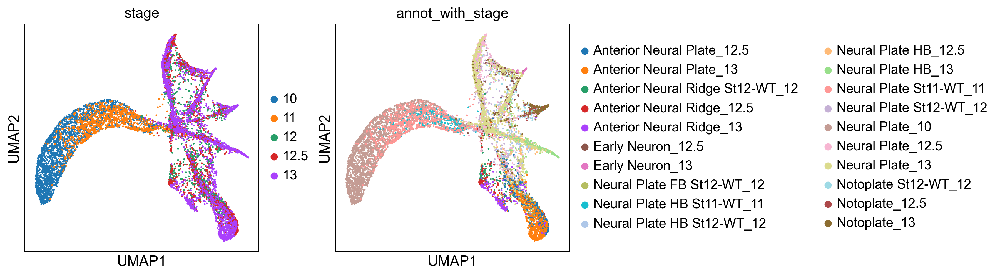

In [12]:
# Increase the number of PCs and neighbors to see how that affects the graph
sce.pp.bbknn(
    adata_HVG, 
    batch_key='stage',
    n_pcs=6,           # Use more principal components (tune this)
    neighbors_within_batch=200,     # Increase the number of nearest neighbors
)

# Then, visualize the effect on UMAP
sc.tl.umap(adata_HVG, min_dist=.25)
sc.pl.umap(adata_HVG, color=['stage', 'annot_with_stage'])


C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\coron\miniconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


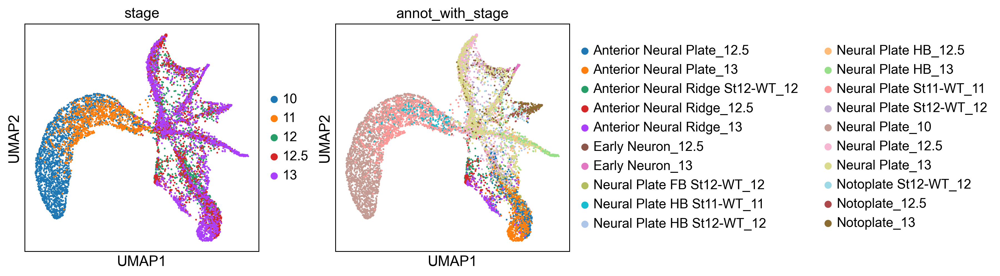

In [243]:
# Increase the number of PCs and neighbors to see how that affects the graph
sce.pp.bbknn(
    adata_HVG, 
    batch_key='stage',
    n_pcs=6,           # Use more principal components (tune this)
    neighbors_within_batch=150,     # Increase the number of nearest neighbors
    local_connectivity=1.75
)

# Then, visualize the effect on UMAP
sc.tl.umap(adata_HVG, min_dist=.35)
sc.pl.umap(adata_HVG, color=['stage', 'annot_with_stage'])


# Calculating Principle Graph

In [36]:
import numpy as np
from sklearn.cluster import KMeans

def _safe_get_partition_modes(mat, init_nodes_pos, labels):
    kmeans = KMeans(n_clusters=len(init_nodes_pos), n_init='auto', random_state=42)
    part = kmeans.fit_predict(mat)
    modes = np.empty(len(init_nodes_pos), dtype=labels.dtype)

    for i in range(len(init_nodes_pos)):
        group = labels[part == i]
        if len(group) == 0:
            # fallback: assign most common label overall
            fallback = np.unique(labels, return_counts=True)[0][0]
            modes[i] = fallback
        else:
            unique_vals, counts = np.unique(group, return_counts=True)
            modes[i] = unique_vals[np.argmax(counts)]

    return modes

# Patch it in
import stream2.tools._elpigraph as _elpigraph
_elpigraph._get_partition_modes = _safe_get_partition_modes


In [245]:
# Convert to categorical codes
adata_HVG.obs['annot_with_stage'] = adata_HVG.obs['annot_with_stage'].astype('category')

# Store the mapping
stage_code_mapping = dict(enumerate(adata_HVG.obs['annot_with_stage'].cat.categories))

# Save numeric codes to a new column
adata_HVG.obs['annot_with_stage_num'] = adata_HVG.obs['annot_with_stage'].cat.codes

for k, v in stage_code_mapping.items():
    print(f"{k}: {v}")

0: Anterior Neural Plate_12.5
1: Anterior Neural Plate_13
2: Anterior Neural Ridge St12-WT_12
3: Anterior Neural Ridge_12.5
4: Anterior Neural Ridge_13
5: Early Neuron_12.5
6: Early Neuron_13
7: Neural Plate FB St12-WT_12
8: Neural Plate HB St11-WT_11
9: Neural Plate HB St12-WT_12
10: Neural Plate HB_12.5
11: Neural Plate HB_13
12: Neural Plate St11-WT_11
13: Neural Plate St12-WT_12
14: Neural Plate_10
15: Neural Plate_12.5
16: Neural Plate_13
17: Notoplate St12-WT_12
18: Notoplate_12.5
19: Notoplate_13


In [246]:
adata_HVG.obs["annot_with_stage_num"] = adata_HVG.obs["annot_with_stage_num"].astype(int)


In [247]:
# First, check the current unique values
print(adata_HVG.obs['annot_with_stage'].unique())

# Reassign 'Neural Plate HB St11-WT_11' to 'Neural Plate St11-WT_11'
adata_HVG.obs['annot_with_stage'] = adata_HVG.obs['annot_with_stage'].replace({
    'Neural Plate HB St11-WT_11': 'Neural Plate St11-WT_11'
})

# If it's a categorical column, remove unused categories
if adata_HVG.obs['annot_with_stage'].dtype.name == 'category':
    adata_HVG.obs['annot_with_stage'] = adata_HVG.obs['annot_with_stage'].cat.remove_unused_categories()


['Neural Plate_10', 'Neural Plate HB St11-WT_11', 'Neural Plate St11-WT_11', 'Neural Plate St12-WT_12', 'Anterior Neural Ridge St12-WT_12', ..., 'Anterior Neural Plate_13', 'Neural Plate_13', 'Neural Plate HB_13', 'Notoplate_13', 'Early Neuron_13']
Length: 20
Categories (20, object): ['Anterior Neural Plate_12.5', 'Anterior Neural Plate_13', 'Anterior Neural Ridge St12-WT_12', 'Anterior Neural Ridge_12.5', ..., 'Neural Plate_13', 'Notoplate St12-WT_12', 'Notoplate_12.5', 'Notoplate_13']


In [248]:
paths_favored = [
    [14, 12],  # Neural Plate_10 → Neural Plate St11-WT_11
    [14, 8],   # Neural Plate_10 → Neural Plate HB St11-WT_11

    [12, 7],   # Neural Plate St11-WT_11 → Neural Plate FB St12-WT_12
   # [12, 2],   # Neural Plate St11-WT_11 → Anterior Neural Ridge St12-WT_12
    [12, 17],  # Neural Plate St11-WT_11 → Notoplate St12-WT_12
    [12, 13],  # Neural Plate St11-WT_11 → Neural Plate St12-WT_12

    [8, 9],    # Neural Plate HB St11-WT_11 → Neural Plate HB St12-WT_12
    [13, 2],   # Neural Plate St12-WT_12 → Anterior Neural Ridge St12-WT_12
    [15, 2],   # Neural Plate St12-WT_12 → Anterior Neural Ridge St12-WT_12
    [15, 3],   # Neural Plate St12-WT_12 → Anterior Neural Ridge St12-WT_12


    [7, 0],    # Neural Plate FB St12-WT_12 → Anterior Neural Plate_12.5
    [0, 1],    # Anterior Neural Plate_12.5 → Anterior Neural Plate_13

    [9, 10],   # Neural Plate HB St12-WT_12 → Neural Plate HB_12.5
    [10, 11],  # Neural Plate HB_12.5 → Neural Plate HB_13

    [17, 18],  # Notoplate St12-WT_12 → Notoplate_12.5
    [18, 19],  # Notoplate_12.5 → Notoplate_13

    [13, 5],   # Neural Plate St12-WT_12 → Early Neuron_12.5
    [5, 6]     # Early Neuron_12.5 → Early Neuron_13
]

paths_disfavored = [
    [19, 11],
    [19, 1],
    [19, 6],
    [19, 4],
    [11, 1],
    [11, 6],
    [11, 4],
    [1, 6],
    [1, 4],
    [6, 4]
]

st2.tl.seed_graph(
    adata_HVG,
    obsm="X_umap",
    n_clusters=7,
    label="annot_with_stage_num",
    label_strength=100.0,
    paths_favored=paths_favored,
    paths_disfavored=paths_disfavored,
    use_weights=False
)


Seeding initial graph...
Clustering...
K-Means clustering ...
Calculating minimum spanning tree...
Found label(s) [ 1  2  3  5  6  7  8  9 10 12 13 17 18 19] with no representative node. Adding label centroid(s) as node(s)


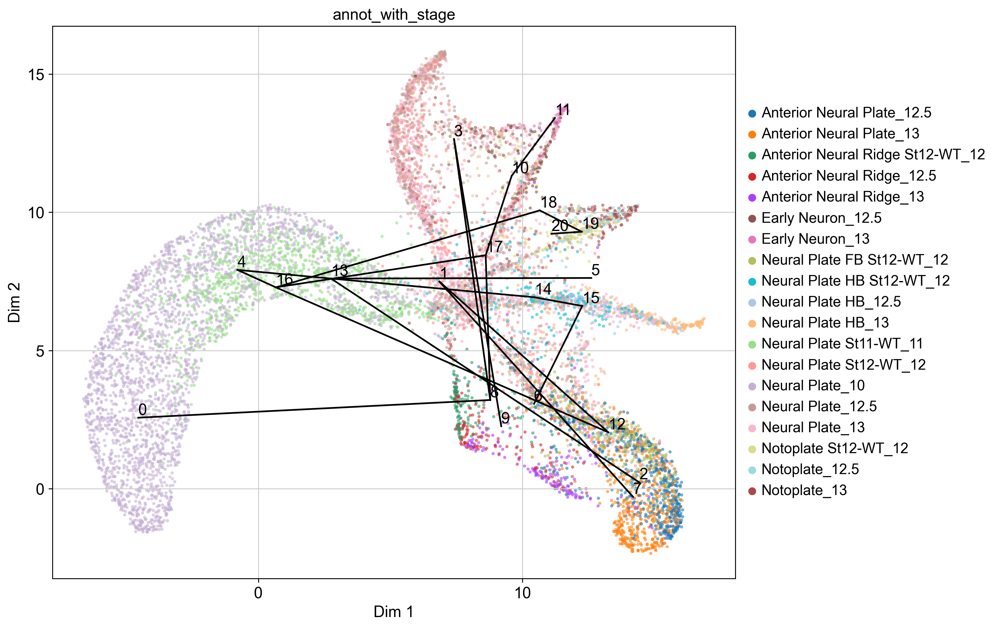

In [249]:
st2.pl.graph(adata_HVG,show_text=True,alpha=0.6,color=['annot_with_stage'],key='seed_epg', fig_size=(12, 8))

In [250]:
st2.tl.learn_graph(adata_HVG, obsm='X_umap', n_nodes=65, method='principal_tree',)

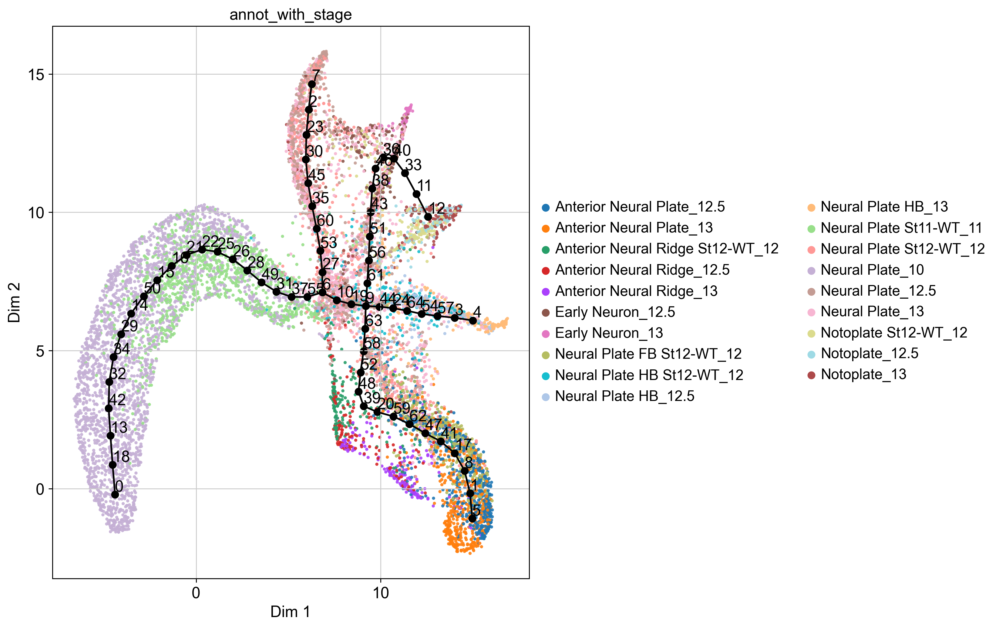

In [251]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [252]:
st2.tl.del_path(adata_HVG,11,9)

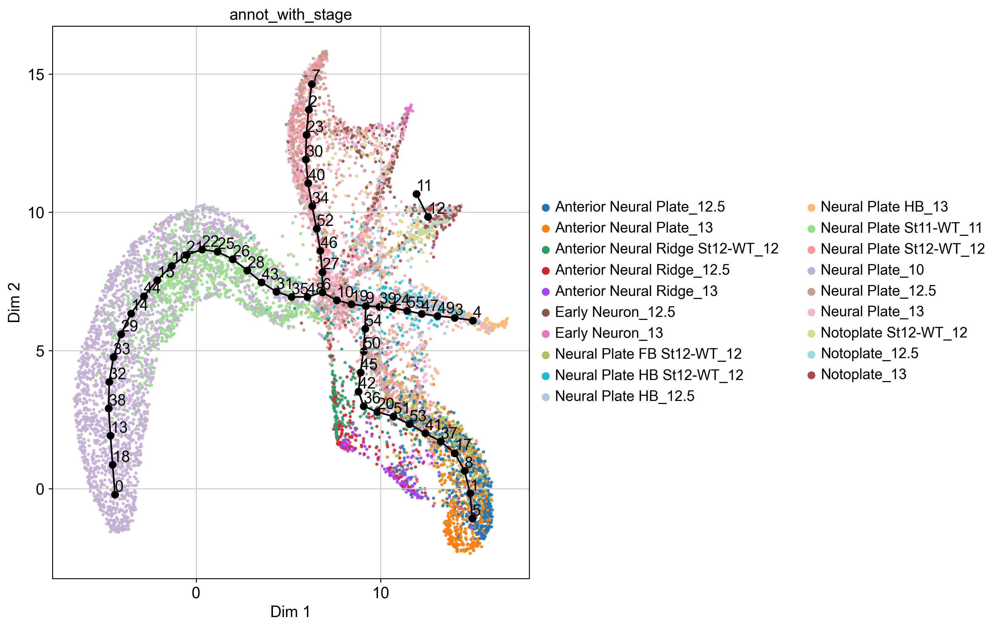

In [253]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


In [254]:
st2.tl.del_path(adata_HVG,9,37)

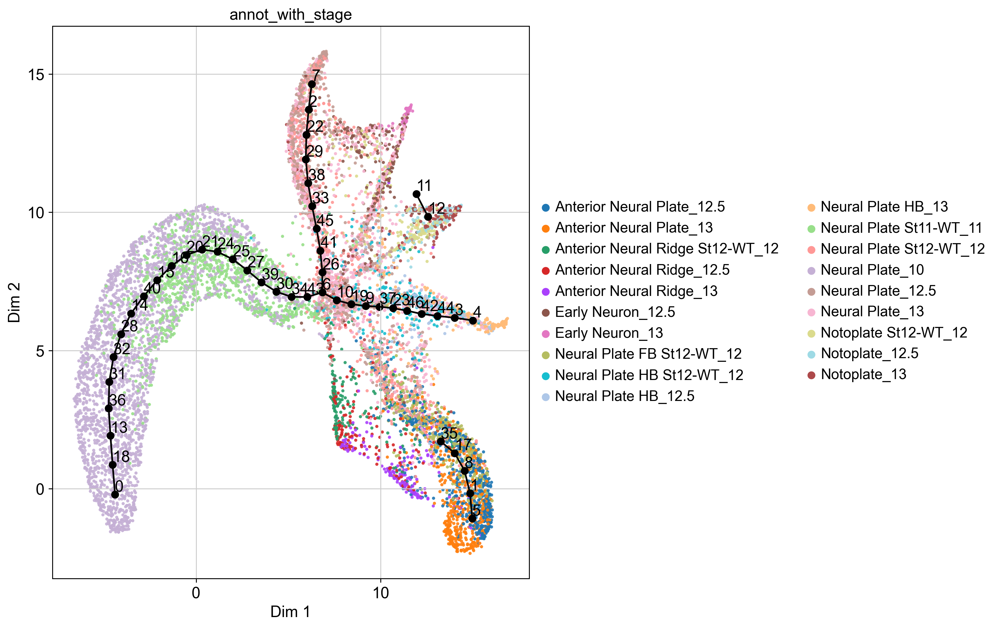

In [255]:
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 8),               # Make figure larger
             # Optional: reduce legend font size
)


# Path Refinement

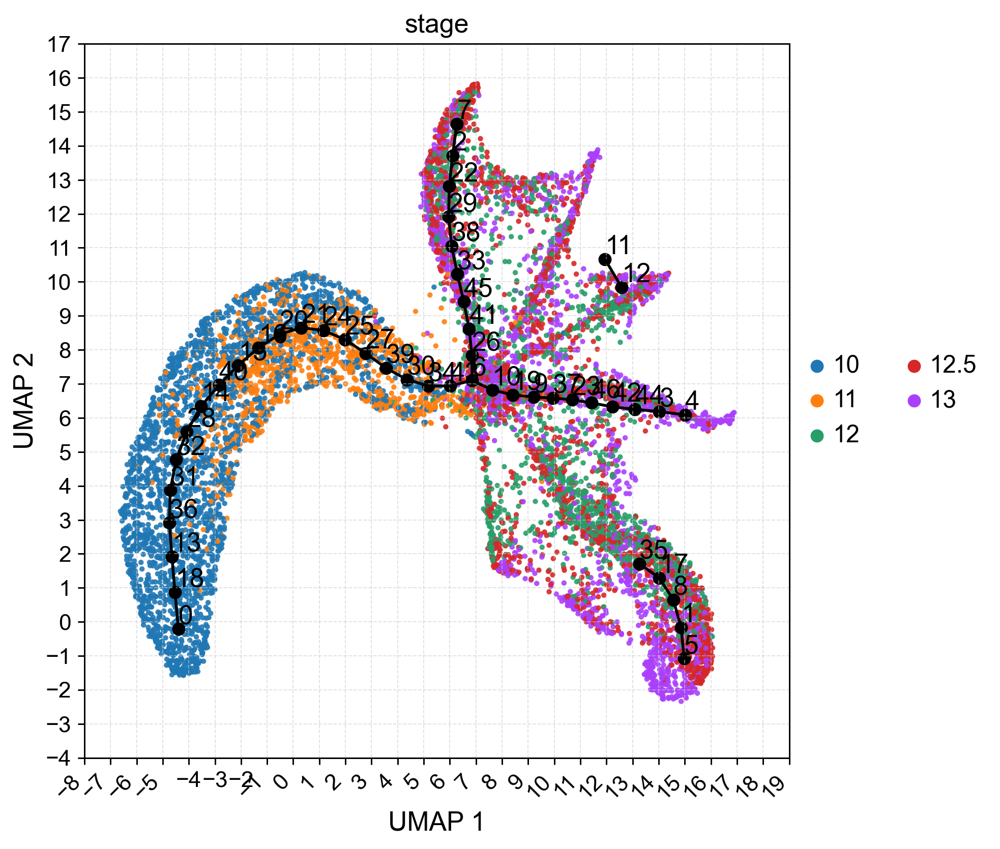

In [256]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [257]:
st2.tl.add_path(adata_HVG,6,[7.4,4.5],n_nodes=None,epg_mu=1)

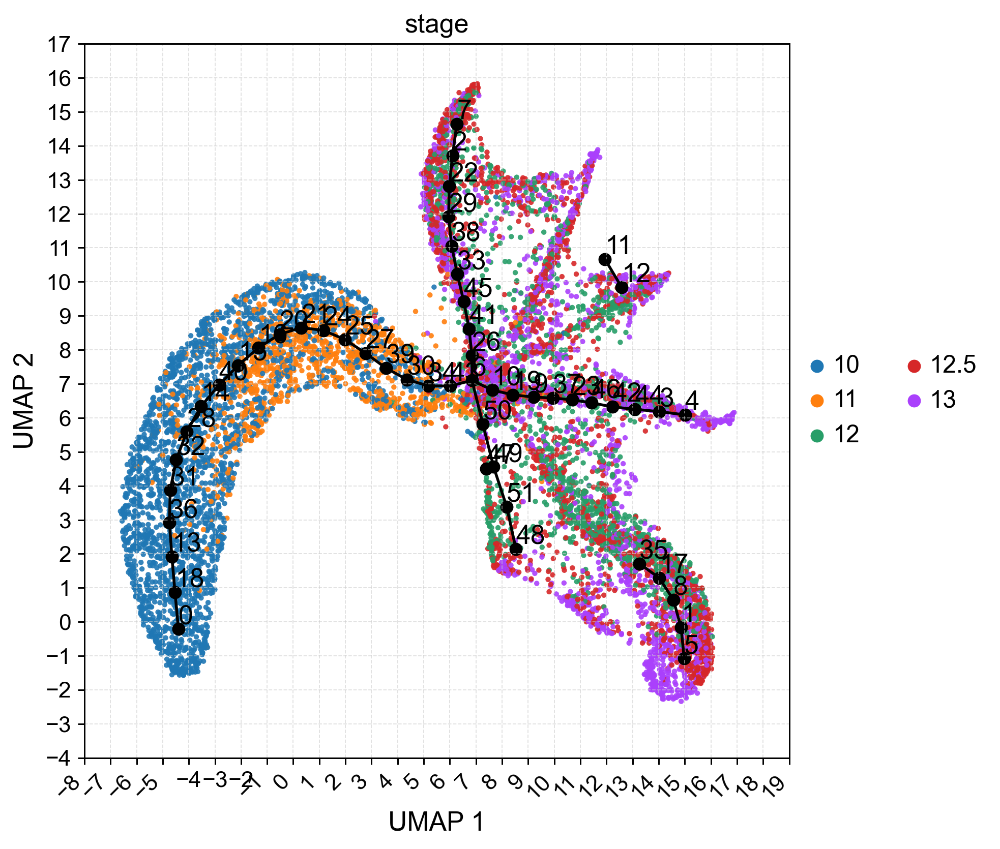

In [258]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [259]:
st2.tl.del_path(adata_HVG,49,48)

In [277]:
st2.tl.del_path(adata_HVG,11,12)

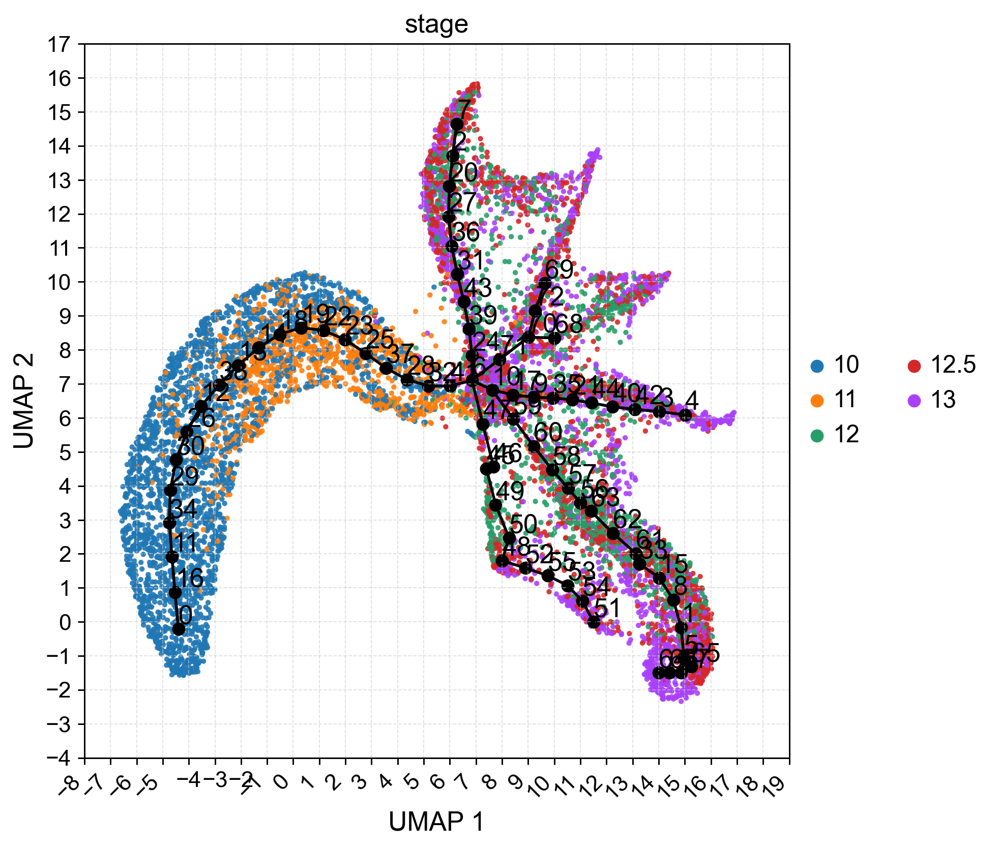

In [278]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [279]:
st2.tl.add_path(adata_HVG,4,[16.8,6],n_nodes=None,epg_mu=1)

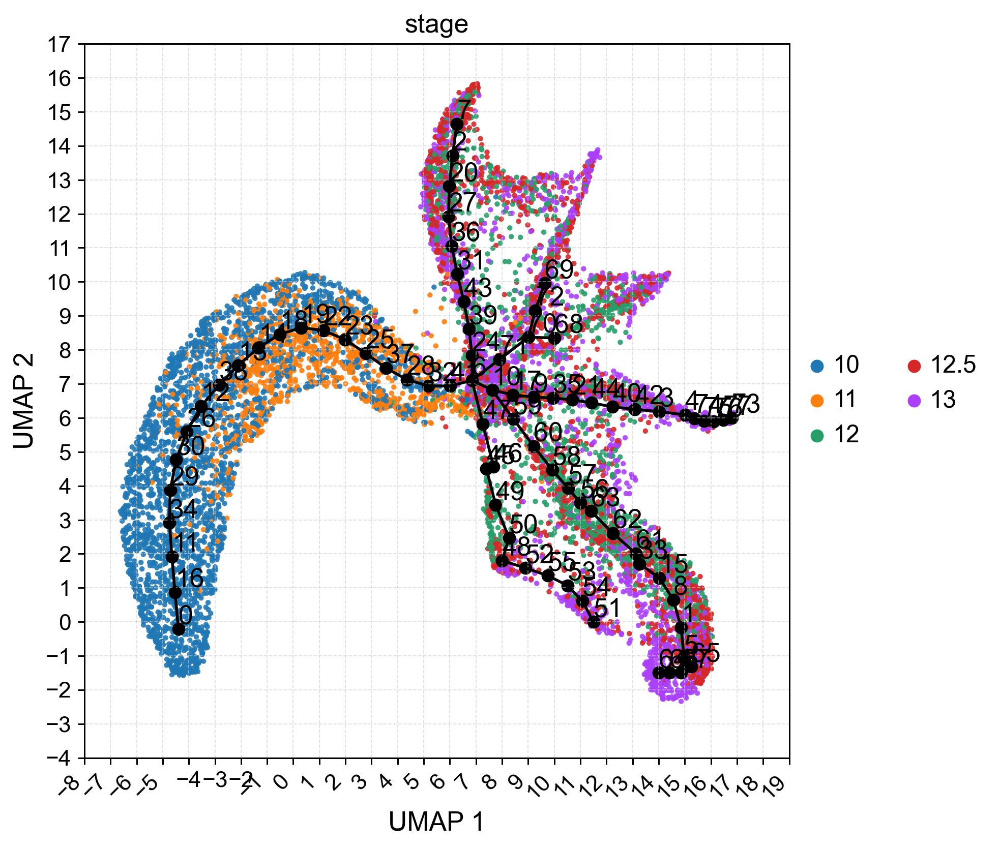

In [280]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [281]:
st2.tl.add_path(adata_HVG,68,[14,10],n_nodes=None,epg_mu=1)

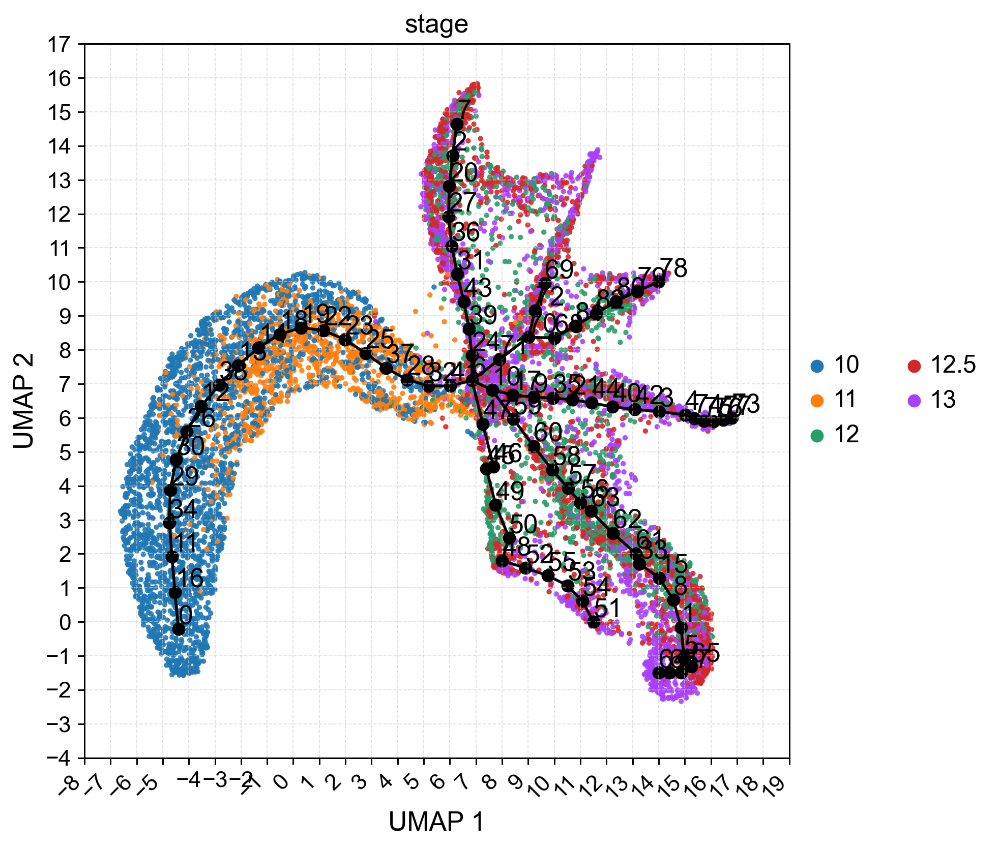

In [282]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [283]:
st2.tl.add_path(adata_HVG,69,[11.65,13.65],n_nodes=None,epg_mu=1)

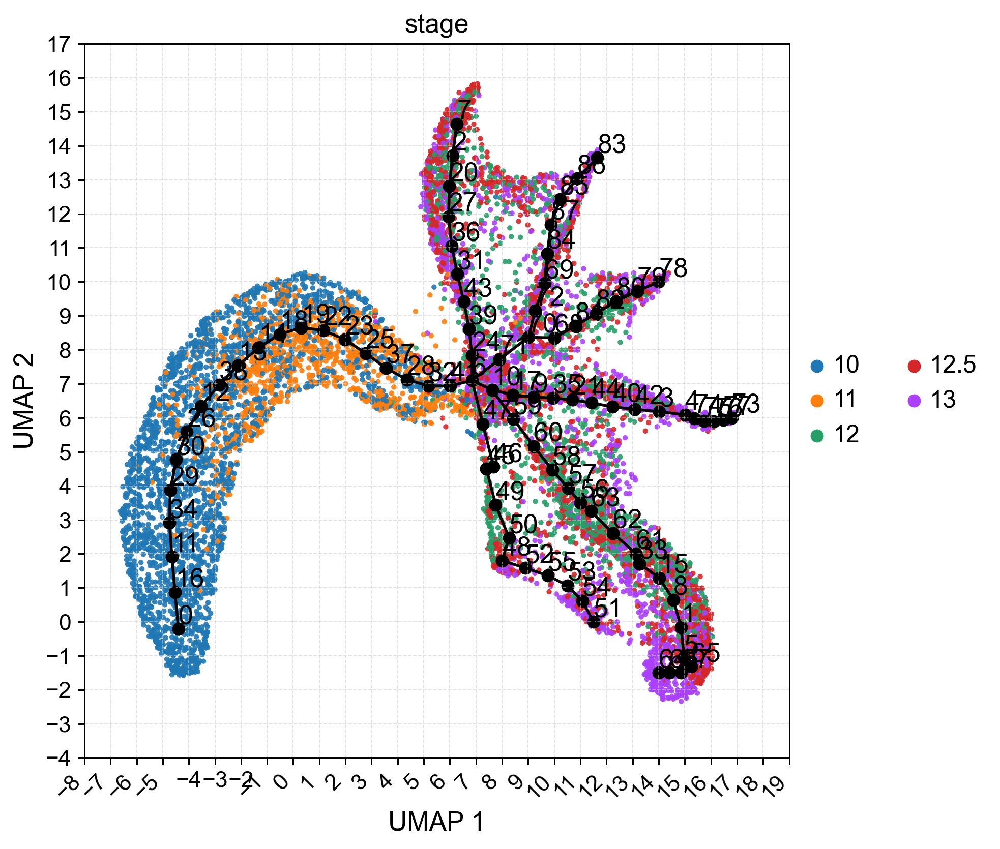

In [284]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [285]:
st2.tl.del_path(adata_HVG,67,66)

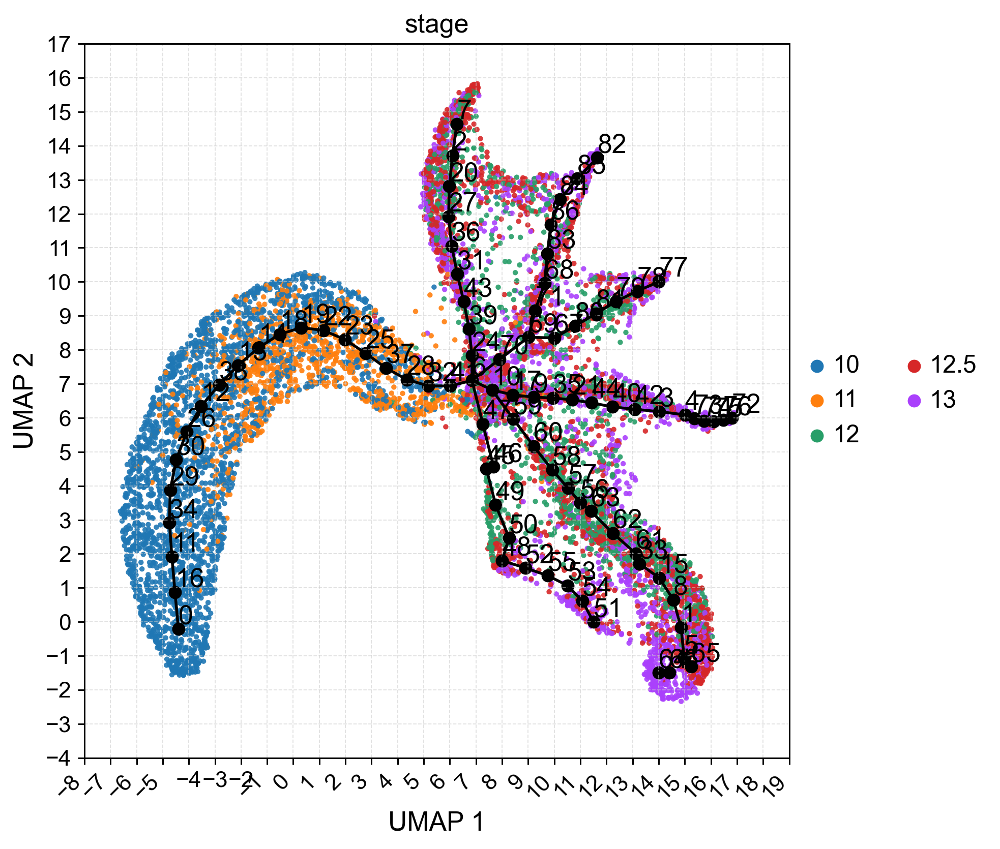

In [286]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


In [160]:
adata_HVG.uns['seed_epg'].keys()


dict_keys(['node_pos', 'edge', 'params', 'conn', 'edge_len'])

In [287]:
import networkx as nx

edges = adata_HVG.uns['epg']['edge']
G = nx.Graph()
G.add_edges_from(edges)

components = list(nx.connected_components(G))
print(f"Number of connected components: {len(components)}")

for i, comp in enumerate(components):
    print(f"Component {i} has {len(comp)} nodes: {sorted(comp)}")


Number of connected components: 2
Component 0 has 85 nodes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 65, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86]
Component 1 has 2 nodes: [64, 66]


In [288]:
st2.tl.del_path(adata_HVG,64,66)

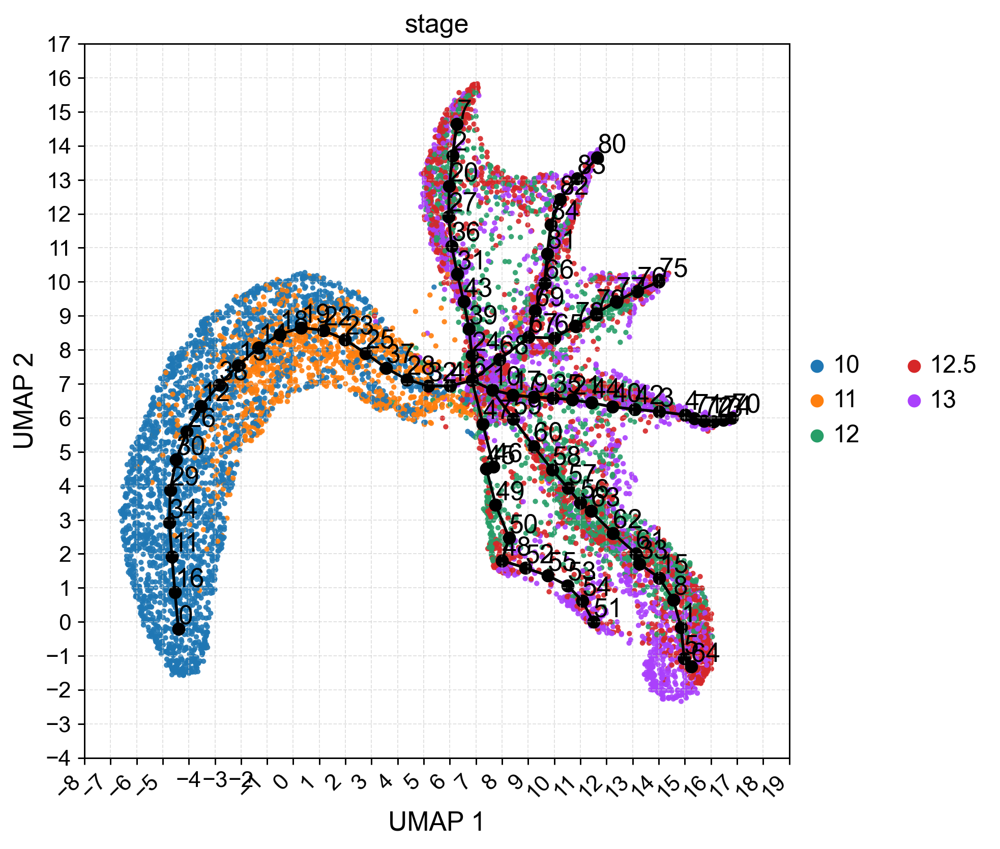

In [289]:
import numpy as np
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(7.25, 6.5)
)

# Get the figure and axes
fig = plt.gcf()
axs = fig.get_axes()

for ax in axs:
    # (other config here...)

    # Rotate x-axis tick labels
    for label in ax.get_xticklabels():
        label.set_rotation(45)  # or try 30, 60, depending on what works best
        label.set_horizontalalignment('right')  # makes it align nicely

    # rest of your code

    # Define custom tick positions (adjust step as needed)
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xticks = np.arange(np.floor(xlim[0]), np.ceil(xlim[1]) + 1, 1)
    yticks = np.arange(np.floor(ylim[0]), np.ceil(ylim[1]) + 1, 1)

    ax.set_xticks(xticks)
    ax.set_yticks(yticks)

    # Make gridlines visible and pretty
    ax.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)

    # Optional: Label tweaks
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel('UMAP 1', fontsize=14)
    ax.set_ylabel('UMAP 2', fontsize=14)

plt.tight_layout()
plt.show()


# Final Figures

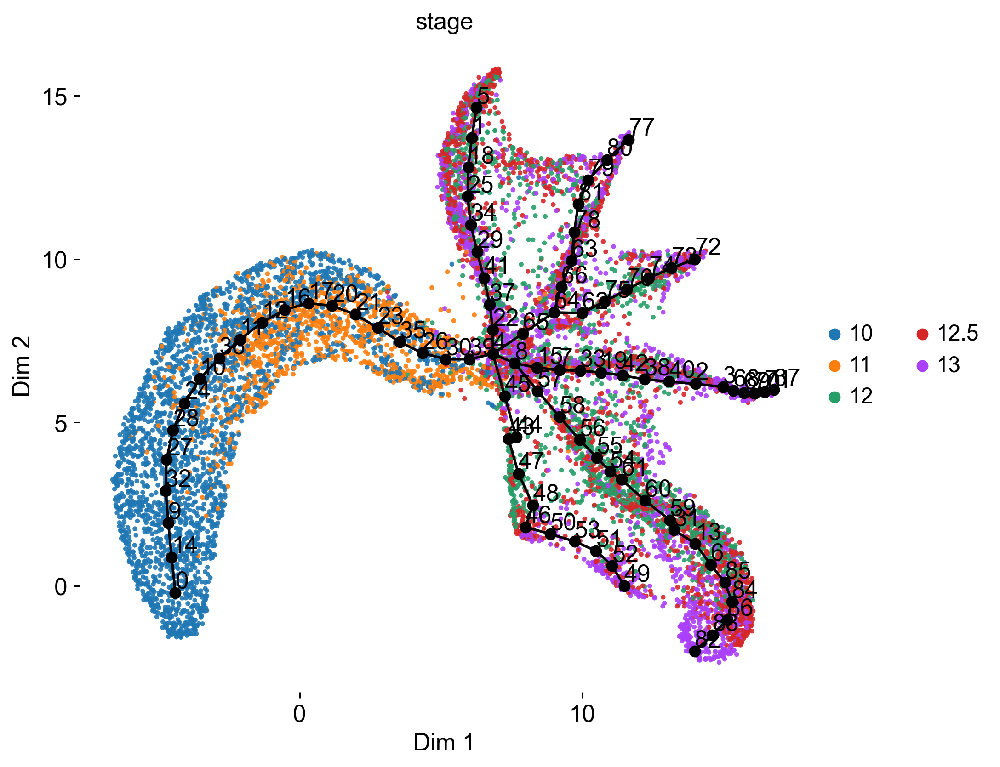

In [354]:
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(8, 6.5)
)

# Modify all axes: turn off grid and remove the frame (spines)
for ax in plt.gcf().axes:
    ax.grid(False)  # Remove grid
    for spine in ax.spines.values():
        spine.set_visible(False)  # Remove all spines (frame)

plt.show()


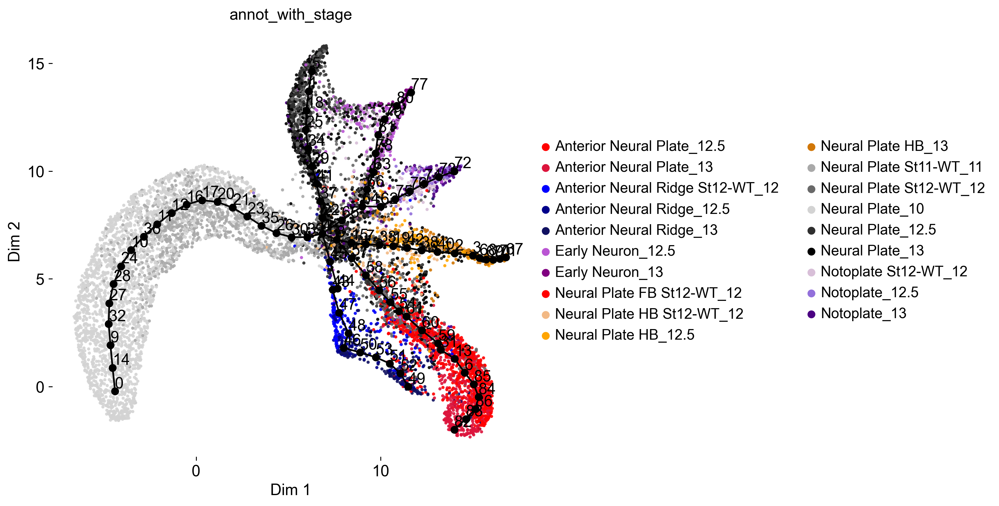

In [306]:
import matplotlib.pyplot as plt

# Plot the STREAM2 graph
st2.pl.graph(
    adata_HVG,
    color=['annot_with_stage'],
    show_text=True,
    show_node=True,
    fig_legend_ncol=2,
    fig_size=(12, 6.5),
    dict_palette={'annot_with_stage': custom_palette},
)

# Modify all axes: turn off grid and remove the frame (spines)
for ax in plt.gcf().axes:
    ax.grid(False)  # Remove grid
    for spine in ax.spines.values():
        spine.set_visible(False)  # Remove all spines (frame)

plt.show()


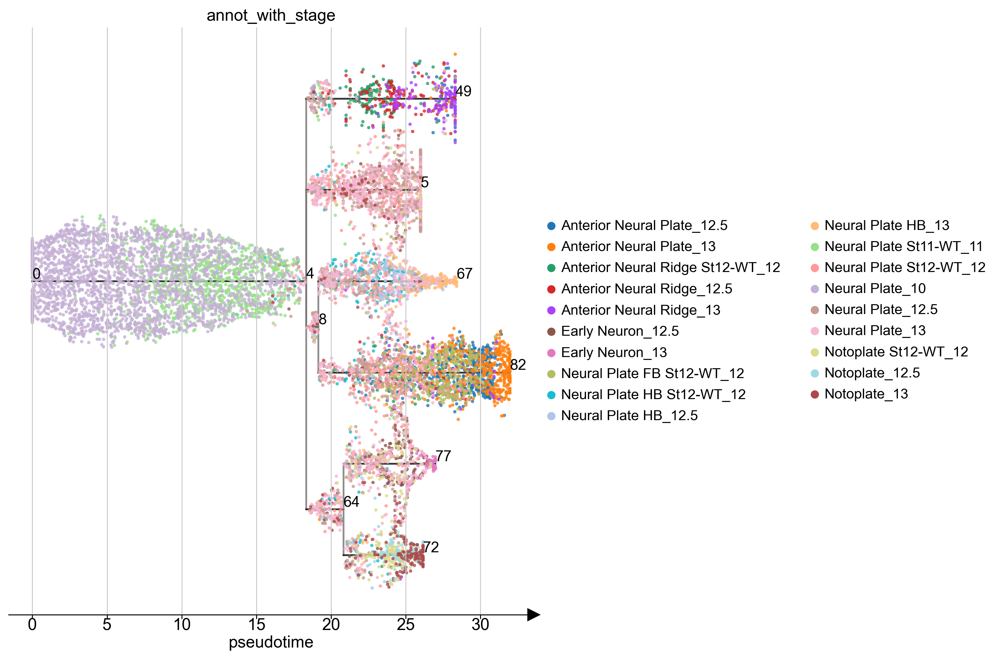

In [356]:
import matplotlib.pyplot as plt

# Run your original plotting function without the unsupported argument
st2.pl.stream_sc(adata_HVG, 
                 source=0, 
                 dist_scale=1, 
                 color=['annot_with_stage'],
                 fig_ncol=2,
                 fig_legend_ncol=2,
                 fig_size=(12, 8),  # You can use this!
                 save_fig=False)

# Now modify the plot
fig = plt.gcf()
fig.set_size_inches(12, 8)  # Bigger figure size

# Adjust legend font size
for ax in fig.axes:
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(12)  # Smaller legend text
        leg.set_title(leg.get_title().get_text(), prop={'size': 12})  # Smaller legend title

plt.tight_layout()
plt.show()


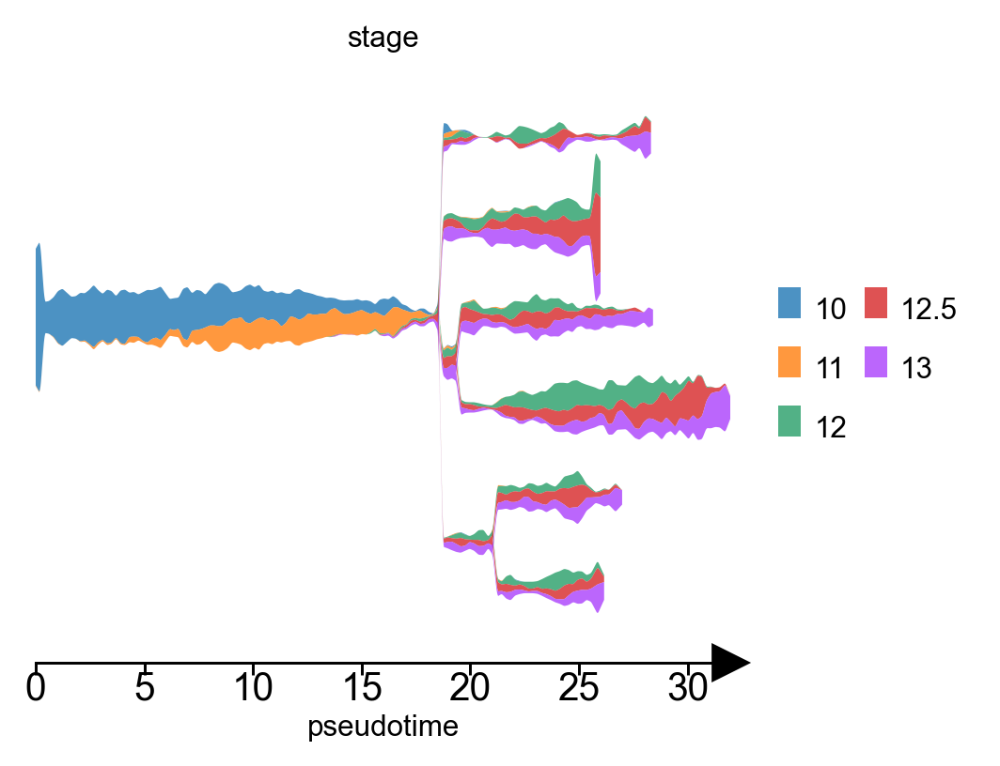

In [309]:
st2.pl.stream(
    adata_HVG,
    source=0,
    dist_scale=1.7,
    color='stage',
    fig_legend_ncol=2,
    fig_size=(12, 4.5),
    save_fig=False,
    vmax=1
)

# Modify the plot
fig = plt.gcf()
fig.set_size_inches(4.25, 3.3)

for ax in fig.axes:
    ax.grid(False)  # Remove gridlines

    # Update tick label font sizes
    ax.tick_params(axis='both', labelsize=11)

    # Update axis label font sizes
    if ax.get_xlabel():
        ax.set_xlabel(ax.get_xlabel(), fontsize=8.5)
    if ax.get_ylabel():
        ax.set_ylabel(ax.get_ylabel(), fontsize=8.5)

    # Update title font size if present
    if ax.get_title():
        ax.set_title(ax.get_title(), fontsize=8.5)

    # Update legend font sizes
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(8.5)
        leg.set_title(leg.get_title().get_text(), prop={'size': 8.5})

plt.tight_layout()
plt.show()


In [310]:
custom_palette = {
    'Anterior Neural Plate_12.5': '#FF0000',   # bluish purple1
    'Anterior Neural Plate_13':   '#DC143C',   # darker bluish purple1
    'Anterior Neural Ridge St12-WT_12': '#0000FF',  # light reddish purple1
    'Anterior Neural Ridge_12.5': '#00008B',   # reddish purple1
    'Anterior Neural Ridge_13':   '#101061',   # darker reddish purple1
    'Early Neuron_12.5':          '#BA55D3',   # red (bright tomato red)1
    'Early Neuron_13':            '#800080',   # crimson but not too dark
    'Neural Plate FB St12-WT_12': '#FF0000',   # light bluish purple (lilac)1
    'Neural Plate HB St12-WT_12': '#f2b985',   # light orange (sandy brown)1
    'Neural Plate HB_12.5':       '#FFA500',   # orange1
    'Neural Plate HB_13':         '#d17708',   # dark orange1
    'Neural Plate St11-WT_11':    '#A9A9A9',   # lighter gray1
    'Neural Plate St12-WT_12':    '#696969',   # gray1
    'Neural Plate_10':            '#D3D3D3',   # lightest gray (white smoke)1
    'Neural Plate_12.5':          '#2F2F2F',   # dark gray (dim gray)1
    'Neural Plate_13':            '#000000',   # darkest gray (dark slate gray)1
    'Notoplate St12-WT_12':       '#D8BFD8',   # lighter blue (light sky blue)
    'Notoplate_12.5':             '#9370DB',   # blue (steel blue)
    'Notoplate_13':               '#4B0082'    # darker blue (navy-inspired)
}


C:\Users\coron\miniconda3\Lib\site-packages\stream2\plotting\_plot.py:1827: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(pad=pad, h_pad=h_pad, w_pad=w_pad)
C:\Users\coron\AppData\Local\Temp\ipykernel_1904\2278347339.py:39: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


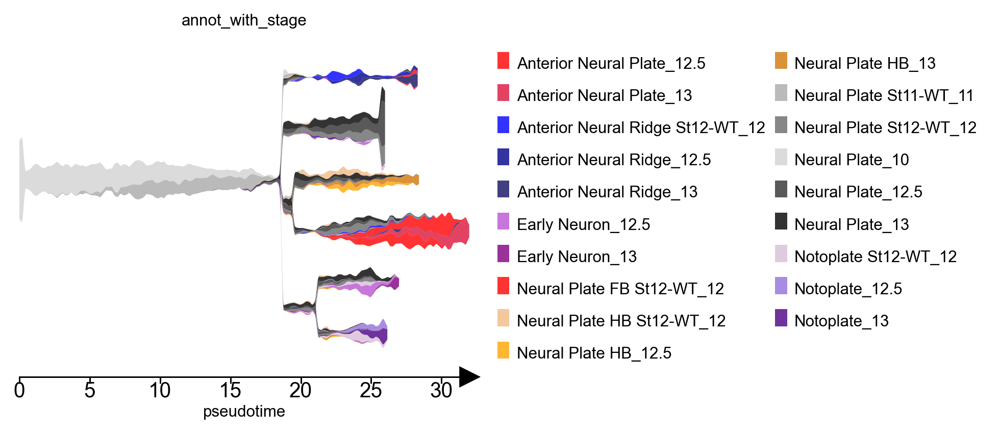

In [311]:
st2.pl.stream(
    adata_HVG,
    source=0,
    dist_scale=1.7,
    color='annot_with_stage',
    dict_palette={'annot_with_stage': custom_palette},
    fig_legend_ncol=2,
    fig_size=(4.25, 3.3),
    save_fig=False
)

# Modify the plot
fig = plt.gcf()
fig.set_size_inches(4.25, 3.3)

for ax in fig.axes:
    ax.grid(False)  # Remove gridlines

    # Update tick label font sizes
    ax.tick_params(axis='both', labelsize=11)

    # Update axis label font sizes
    if ax.get_xlabel():
        ax.set_xlabel(ax.get_xlabel(), fontsize=8.5)
    if ax.get_ylabel():
        ax.set_ylabel(ax.get_ylabel(), fontsize=8.5)

    # Update title font size if present
    if ax.get_title():
        ax.set_title(ax.get_title(), fontsize=8.5)

    # Update legend font sizes
    leg = ax.get_legend()
    if leg:
        for text in leg.get_texts():
            text.set_fontsize(8.5)
        leg.set_title(leg.get_title().get_text(), prop={'size': 8.5})

plt.tight_layout()
plt.show()